<a href="https://colab.research.google.com/github/CAkshay123/Projects/blob/main/Cifar10_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import tensorflow as tf

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix,ConfusionMatrixDisplay

In [ ]:
(x_train,y_train),(x_test,y_test)=tf.keras.datasets.cifar10.load_data()
#imports tensorflow, numpy and loads data

170498071/170498071 [==============================] - 15s 0us/step


In [ ]:
#this cell one-hot encodes the labels
k=np.array(range(10))
y_train=(y_train==k).astype(int)
y_test=(y_test==k).astype(int)

#1 **Preparing Data**

### 1.   Viewing Data


*   Each instance has numpy array of (32,32,3) and label ,an integer from 0 to 9
*   There is 50000 training data and 10000 test data




In [ ]:
type(x_train)

numpy.ndarray

In [ ]:
x_train.shape

(50000, 32, 32, 3)

In [ ]:
x_test.shape

(10000, 32, 32, 3)

In [ ]:
type(y_train),y_train.shape

(numpy.ndarray, (50000, 1))

In [ ]:
import matplotlib.pyplot as plt


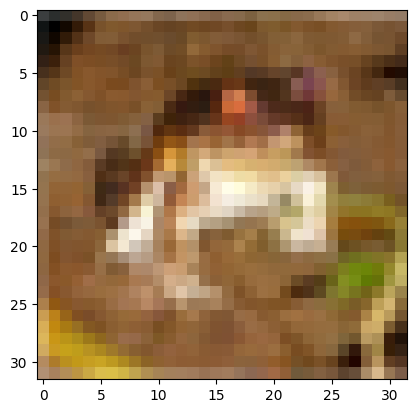

In [ ]:
plt.imshow(x_train[0])

#2 **Preprocessing data**

###   Converting data to tensors





In [ ]:
def to_tensors(x,y):
  """
  takes x,y as numpy image and label,
  convert it to normalised tensors
  """
  newx=tf.image.convert_image_dtype(x,dtype=tf.float32)
  newy=tf.convert_to_tensor(y)
  return newx,newy


### Data Augmentation

In [ ]:
data_augment=tf.keras.Sequential([
    tf.keras.layers.RandomFlip(mode="horizontal"),
    tf.keras.layers.RandomRotation(factor=0.05)
])

In [ ]:
from sklearn.model_selection import train_test_split
def dataaug(x,y,aug_size):
  """
  gives augmented data by random flip and random rotation,
  inputs x,y as numpy and `aug_size` as values between 0 and 1
  telling how much augmentation is needed
  :if augmentation is required to change, change it from
  `data_augment` sequential model
  """
  xtr,xte,ytr,yte=train_test_split(x,y,test_size=aug_size)
  aug_data=data_augment(xte)
  aug_data=tf.clip_by_value(aug_data,0,255)
  aug_data=aug_data/255

  yte=tf.convert_to_tensor(yte)

  return aug_data,yte



### Converting to Datasets shuffling and Batching

In [ ]:
def preprocessing(x,y,batch_size=32,aug_size=None,val_size=None):
  """
  takes x,y numpy : augments the data by aug_size (0 to 1) if specified
  and returns the batched Dataset or
  batched training and validation Dataset if val_size is specified
  """
  if aug_size!=None:
    augx,augy=dataaug(x,y,aug_size)

    x,y=to_tensors(x,y)

    x=tf.concat([x,augx],axis=0)
    y=tf.concat([y,augy],axis=0)


    data=tf.data.Dataset.from_tensor_slices((x,y))
    m=len(x)
    data=data.shuffle(buffer_size=m)


    if val_size!=None:
      val_number=int(m*val_size)
      train_size=1-val_size
      train_number=int(m*train_size)

      train_data=data.take(train_number)
      val_data=data.skip(train_number).take(val_number)

      train_data=train_data.batch(batch_size)
      val_data=val_data.batch(batch_size)

      return train_data,val_data

    else:
      return data.batch(batch_size)


  else:
    x,y=to_tensors(x,y)
    data=tf.data.Dataset.from_tensor_slices((x,y))
    m=len(x)
    data=data.shuffle(buffer_size=m)

    if val_size!=None:
      val_number=int(m*val_size)
      train_size=1-val_size
      train_number=int(m*train_size)

      train_data=data.take(train_number)
      val_data=data.skip(train_number).take(val_number)

      train_data=train_data.batch(batch_size)
      val_data=val_data.batch(batch_size)
      return train_data,val_data

    else:
      return data.batch(batch_size)


In [ ]:
tf.__version__

'2.12.0'

#3 **Dense Model**

In [ ]:
dense_model=tf.keras.Sequential([tf.keras.layers.Flatten(),
                     tf.keras.layers.Dense(3072, activation="relu"),
                     tf.keras.layers.Dense(1024, activation="relu"),
                     tf.keras.layers.Dense(512, activation="relu"),
                     tf.keras.layers.Dense(256, activation="relu"),
                     tf.keras.layers.Dense(128, activation="relu"),
                     tf.keras.layers.Dense(64, activation="relu"),
                     tf.keras.layers.Dense(10, activation="softmax")])

dense_model.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])

In [ ]:
data=preprocessing(x_train,y_train)

In [ ]:
history=dense_model.fit(data,epochs=30)

Epoch 1/30
1563/1563 [==============================] - 18s 6ms/step - loss: 1.9616 - accuracy: 0.2724
Epoch 2/30
1563/1563 [==============================] - 10s 6ms/step - loss: 1.7559 - accuracy: 0.3637
Epoch 3/30
1563/1563 [==============================] - 11s 7ms/step - loss: 1.6657 - accuracy: 0.4012
Epoch 4/30
1563/1563 [==============================] - 10s 6ms/step - loss: 1.6015 - accuracy: 0.4256
Epoch 5/30
1563/1563 [==============================] - 10s 6ms/step - loss: 1.5530 - accuracy: 0.4426
Epoch 6/30
1563/1563 [==============================] - 9s 6ms/step - loss: 1.5122 - accuracy: 0.4586
Epoch 7/30
1563/1563 [==============================] - 11s 7ms/step - loss: 1.4788 - accuracy: 0.4709
Epoch 8/30
1563/1563 [==============================] - 10s 6ms/step - loss: 1.4442 - accuracy: 0.4855
Epoch 9/30
1563/1563 [==============================] - 10s 6ms/step - loss: 1.4185 - accuracy: 0.4933
Epoch 10/30
1563/1563 [==============================] - 10s 6ms/step - lo

In [ ]:
a,b=to_tensors(x_test,y_test)
dense_model.evaluate(a,b)

313/313 [==============================] - 1s 3ms/step - loss: 1.7679 - accuracy: 0.4827


[1.7678788900375366, 0.482699990272522]

In [ ]:
dense_model.save("drive/MyDrive/Colab Notebooks/Cifar10/saves/dense_model",save_format='tf')

In [ ]:
dense_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 3072)              0         
                                                                 
 dense (Dense)               (None, 3072)              9440256   
                                                                 
 dense_1 (Dense)             (None, 1024)              3146752   
                                                                 
 dense_2 (Dense)             (None, 512)               524800    
                                                                 
 dense_3 (Dense)             (None, 256)               131328    
                                                                 
 dense_4 (Dense)             (None, 128)               32896     
                                                                 
 dense_5 (Dense)             (None, 64)                8

In [ ]:
a,b=to_tensors(x_test,y_test)
y_preds=dense_model.predict(a)
y_preds=[np.argmax(x) for x in y_preds]
y_true=[np.argmax(x) for x in y_test]

313/313 [==============================] - 1s 2ms/step


In [ ]:
print(classification_report(y_preds,y_true))

              precision    recall  f1-score   support

           0       0.55      0.53      0.54      1031
           1       0.60      0.59      0.60      1012
           2       0.35      0.41      0.38       866
           3       0.39      0.32      0.35      1220
           4       0.36      0.44      0.40       829
           5       0.37      0.41      0.39       919
           6       0.59      0.46      0.51      1286
           7       0.45      0.59      0.51       761
           8       0.68      0.57      0.62      1193
           9       0.49      0.55      0.52       883

    accuracy                           0.48     10000
   macro avg       0.48      0.49      0.48     10000
weighted avg       0.49      0.48      0.48     10000



In [ ]:
print(confusion_matrix(y_preds,y_true))

[[546  41  89  39  56  30  15  58  94  63]
 [ 47 600  17  23  10  13  17  28  73 184]
 [ 50  18 353  69 135  87  58  74   9  13]
 [ 57  43 134 391  98 243  94  77  40  43]
 [ 20  12 115  36 362  40 108  99  19  18]
 [ 18  12  73 173  57 374  71  94  17  30]
 [ 32  25 122 168 152 106 588  47  16  30]
 [ 19  11  50  36  75  52  19 450   6  43]
 [175  90  32  28  41  32  11  19 676  89]
 [ 36 148  15  37  14  23  19  54  50 487]]


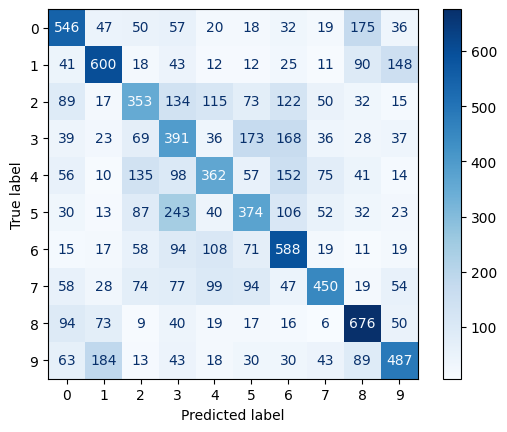

In [ ]:
ConfusionMatrixDisplay.from_predictions(y_true=y_true,y_pred=y_preds,cmap='Blues')

#3 **Custom CNN Model**

## Model

In [ ]:
#the model is custom designed, by referring multiple architecture Like VGG-16, LeNet-5

model_1=tf.keras.Sequential(
                      [tf.keras.layers.Conv2D(filters=32,kernel_size=5,input_shape=[32,32,3],padding='same'),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),

                      tf.keras.layers.Conv2D(filters=64,kernel_size=3,padding='same'),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),


                      tf.keras.layers.Conv2D(filters=64,kernel_size=3,padding='same'),


                      tf.keras.layers.Conv2D(kernel_size=3,filters=128,padding='same'),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),


                      tf.keras.layers.Conv2D(filters=256,kernel_size=3,padding='same'),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),

                      tf.keras.layers.Conv2D(kernel_size=3,filters=256,padding='same'),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),

                      tf.keras.layers.Flatten(),
                      tf.keras.layers.Dense(128,activation='relu'),
                      tf.keras.layers.Dense(64,activation='relu'),
                      tf.keras.layers.Dense(10,activation='softmax')
                       ]
                      )
model_1.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])

In [ ]:
data=preprocessing(x_train,y_train)

In [ ]:
history=model_1.fit(data,epochs=30)

Epoch 1/30
1563/1563 [==============================] - 22s 6ms/step - loss: 1.6982 - accuracy: 0.3655
Epoch 2/30
1563/1563 [==============================] - 10s 6ms/step - loss: 1.2528 - accuracy: 0.5489
Epoch 3/30
1563/1563 [==============================] - 9s 6ms/step - loss: 1.0631 - accuracy: 0.6226
Epoch 4/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.9257 - accuracy: 0.6745
Epoch 5/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.8247 - accuracy: 0.7114
Epoch 6/30
1563/1563 [==============================] - 9s 6ms/step - loss: 0.7437 - accuracy: 0.7412
Epoch 7/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.6686 - accuracy: 0.7656
Epoch 8/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.6101 - accuracy: 0.7875
Epoch 9/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.5461 - accuracy: 0.8084
Epoch 10/30
1563/1563 [==============================] - 9s 6ms/step - loss

In [ ]:
a,b=to_tensors(x_test,y_test)
model_1.evaluate(a,b)

313/313 [==============================] - 1s 4ms/step - loss: 1.4329 - accuracy: 0.7143


[1.4328725337982178, 0.7142999768257141]

In [ ]:
model_1.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 32)        2432      
                                                                 
 activation (Activation)     (None, 32, 32, 32)        0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 16, 16, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 64)        18496     
                                                                 
 activation_1 (Activation)   (None, 16, 16, 64)        0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 8, 8, 64)         0         
 2D)                                                  

In [ ]:
history=model_1.fit(data,epochs=30)

Epoch 1/30
1563/1563 [==============================] - 24s 6ms/step - loss: 1.6112 - accuracy: 0.3986
Epoch 2/30
1563/1563 [==============================] - 12s 8ms/step - loss: 1.1898 - accuracy: 0.5729
Epoch 3/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.9818 - accuracy: 0.6519
Epoch 4/30
1563/1563 [==============================] - 16s 10ms/step - loss: 0.8430 - accuracy: 0.7057
Epoch 5/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.7387 - accuracy: 0.7424
Epoch 6/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.6660 - accuracy: 0.7679
Epoch 7/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.5805 - accuracy: 0.7974
Epoch 8/30
1563/1563 [==============================] - 10s 6ms/step - loss: 0.5245 - accuracy: 0.8189
Epoch 9/30
1563/1563 [==============================] - 9s 6ms/step - loss: 0.4680 - accuracy: 0.8364
Epoch 10/30
1563/1563 [==============================] - 10s 6ms/step - l

In [ ]:
a,b=to_tensors(x_test,y_test)
y_preds=model_1.predict(a)
y_preds=[np.argmax(x) for x in y_preds]
y_true=[np.argmax(x) for x in y_test]

313/313 [==============================] - 1s 2ms/step


In [ ]:
print(classification_report(y_preds,y_true))

              precision    recall  f1-score   support

           0       0.76      0.78      0.77       972
           1       0.86      0.84      0.85      1025
           2       0.65      0.69      0.67       947
           3       0.56      0.51      0.53      1106
           4       0.74      0.66      0.70      1127
           5       0.59      0.67      0.62       880
           6       0.72      0.83      0.77       867
           7       0.78      0.76      0.77      1016
           8       0.84      0.86      0.85       979
           9       0.85      0.78      0.81      1081

    accuracy                           0.74     10000
   macro avg       0.74      0.74      0.74     10000
weighted avg       0.74      0.74      0.74     10000



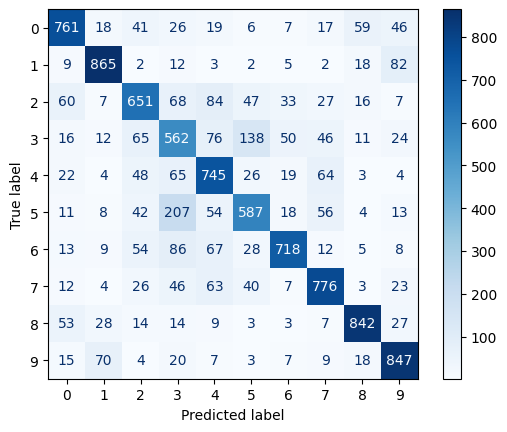

In [ ]:
ConfusionMatrixDisplay.from_predictions(y_true=y_true,y_pred=y_preds,cmap='Blues')

##Final Main Model

In [ ]:
#the model is custom designed, by referring multiple architecture Like VGG-16, LeNet-5
#have implemented increasing dropout for regularisation and BatchNormalisation
model=tf.keras.Sequential(
                      [tf.keras.layers.Conv2D(filters=32,kernel_size=5,input_shape=[32,32,3],padding='same'),
                      tf.keras.layers.BatchNormalization(),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),

                      tf.keras.layers.Conv2D(filters=64,kernel_size=3,padding='same'),
                      tf.keras.layers.BatchNormalization(),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),
                      tf.keras.layers.Dropout(0.2),

                      tf.keras.layers.Conv2D(filters=64,kernel_size=3,padding='same'),


                      tf.keras.layers.Conv2D(kernel_size=3,filters=128,padding='same'),
                      tf.keras.layers.BatchNormalization(),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),
                      tf.keras.layers.Dropout(0.3),

                      tf.keras.layers.Conv2D(filters=256,kernel_size=3,padding='same'),
                      tf.keras.layers.BatchNormalization(),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),
                      tf.keras.layers.Dropout(0.3),

                      tf.keras.layers.Conv2D(kernel_size=3,filters=256,padding='same'),
                      tf.keras.layers.BatchNormalization(),
                      tf.keras.layers.Activation('relu'),
                      tf.keras.layers.MaxPool2D(),

                      tf.keras.layers.Flatten(),
                      tf.keras.layers.Dense(128,activation='relu'),
                      tf.keras.layers.Dropout(0.4),
                      tf.keras.layers.Dense(64,activation='relu'),
                      tf.keras.layers.Dense(10,activation='softmax')
                       ]
                      )
model.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 32, 32, 32)        2432      
                                                                 
 batch_normalization (BatchN  (None, 32, 32, 32)       128       
 ormalization)                                                   
                                                                 
 activation_5 (Activation)   (None, 32, 32, 32)        0         
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 16, 16, 32)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 16, 16, 64)        18496     
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 64)      

## Callbacks

In [ ]:
def create_earlystopping():
  return tf.keras.callbacks.EarlyStopping(monitor="val_loss",patience=10)

In [ ]:
import datetime
import os
def create_tensorboard():
  logs=os.path.join('drive/MyDrive/Colab Notebooks/Cifar10/logtb',datetime.datetime.now().strftime("%d_%m_%Y-%H_%M_%S"))
  return tf.keras.callbacks.TensorBoard(log_dir=logs)

In [ ]:
def create_checkpoints():
  logs=os.path.join('drive/MyDrive/Colab Notebooks/Cifar10/saves/withvalid',datetime.datetime.now().strftime("%d_%m_%Y-%H_%M_%S"))
  logs=os.path.join(logs,'save.h5')
  return tf.keras.callbacks.ModelCheckpoint(filepath=logs,save_best_only=True,save_weights_only=True,verbose=1)
  #,save_best_only=True

## Training

### With validation set

In [ ]:
tb=create_tensorboard()
sav=create_checkpoints()
earlystop=create_earlystopping()

In [ ]:
train,valid=preprocessing(x_train,y_train,aug_size=0.99,val_size=0.15)

while training with validation set here, the validation accuracy is higher than training set accuracy, and it is mainly because validation set contains subset of data_augmentation, in which some images might have got few augmentation,
resulting similar datas in training as well as validation set.

In [ ]:
history=model.fit(train,epochs=300,validation_data=valid,callbacks=[tb,sav,earlystop])

Epoch 1/300
2643/2643 [==============================] - ETA: 0s - loss: 1.5561 - accuracy: 0.4301
Epoch 1: val_loss improved from inf to 1.16772, saving model to drive/MyDrive/Colab Notebooks/Cifar10/saves/withvalid/19_07_2023-07_26_38/save.h5
2643/2643 [==============================] - 44s 10ms/step - loss: 1.5561 - accuracy: 0.4301 - val_loss: 1.1677 - val_accuracy: 0.5672
Epoch 2/300
2641/2643 [============================>.] - ETA: 0s - loss: 1.2038 - accuracy: 0.5743
Epoch 2: val_loss did not improve from 1.16772
2643/2643 [==============================] - 26s 10ms/step - loss: 1.2039 - accuracy: 0.5743 - val_loss: 1.2379 - val_accuracy: 0.5410
Epoch 3/300
2638/2643 [============================>.] - ETA: 0s - loss: 1.0435 - accuracy: 0.6379
Epoch 3: val_loss improved from 1.16772 to 0.98975, saving model to drive/MyDrive/Colab Notebooks/Cifar10/saves/withvalid/19_07_2023-07_26_38/save.h5
2643/2643 [==============================] - 26s 10ms/step - loss: 1.0433 - accuracy: 0.63

In [ ]:
history2=model.fit(train,epochs=300,validation_data=valid,callbacks=[tb,sav,earlystop])

Epoch 1/300
2641/2643 [============================>.] - ETA: 0s - loss: 0.4732 - accuracy: 0.8386
Epoch 1: val_loss improved from inf to 0.39217, saving model to drive/MyDrive/Colab Notebooks/Cifar10/saves/withvalid/19_07_2023-08_02_27/save.h5
2643/2643 [==============================] - 25s 9ms/step - loss: 0.4731 - accuracy: 0.8386 - val_loss: 0.3922 - val_accuracy: 0.8924
Epoch 2/300
2642/2643 [============================>.] - ETA: 0s - loss: 0.4667 - accuracy: 0.8429
Epoch 2: val_loss did not improve from 0.39217
2643/2643 [==============================] - 25s 9ms/step - loss: 0.4667 - accuracy: 0.8429 - val_loss: 0.4424 - val_accuracy: 0.8710
Epoch 3/300
2642/2643 [============================>.] - ETA: 0s - loss: 0.4520 - accuracy: 0.8486
Epoch 3: val_loss improved from 0.39217 to 0.35738, saving model to drive/MyDrive/Colab Notebooks/Cifar10/saves/withvalid/19_07_2023-08_02_27/save.h5
2643/2643 [==============================] - 26s 10ms/step - loss: 0.4519 - accuracy: 0.8485

In [ ]:
# saving the model
model.save("drive/MyDrive/Colab Notebooks/Cifar10/saves/with_valid/model2",save_format='tf')

In [ ]:
model=tf.keras.models.load_model("drive/MyDrive/Colab Notebooks/Cifar10/saves/with_valid/model2")

In [ ]:
a,b=to_tensors(x_test,y_test)
model.evaluate(a,b)

313/313 [==============================] - 1s 4ms/step - loss: 0.4604 - accuracy: 0.8500


[0.4603598117828369, 0.8500000238418579]

Accuracy in test data set is 85%

### Without validation set

In [ ]:
newdata=preprocessing(x_train,y_train,aug_size=0.99)

In [ ]:
len(newdata)

3110

In [ ]:
# stopped training early manually by 100 epochs to prevent overfitting
model.fit(newdata,epochs=200,callbacks=[sav])

Epoch 1/200
3110/3110 [==============================] - ETA: 0s - loss: 1.4992 - accuracy: 0.4546
Epoch 1: saving model to drive/MyDrive/Colab Notebooks/Cifar10/saves/18_07_2023-18_36_59/save.h5
3110/3110 [==============================] - 52s 9ms/step - loss: 1.4992 - accuracy: 0.4546
Epoch 2/200
3105/3110 [============================>.] - ETA: 0s - loss: 1.1403 - accuracy: 0.6021
Epoch 2: saving model to drive/MyDrive/Colab Notebooks/Cifar10/saves/18_07_2023-18_36_59/save.h5
3110/3110 [==============================] - 29s 9ms/step - loss: 1.1402 - accuracy: 0.6021
Epoch 3/200
3110/3110 [==============================] - ETA: 0s - loss: 0.9777 - accuracy: 0.6653
Epoch 3: saving model to drive/MyDrive/Colab Notebooks/Cifar10/saves/18_07_2023-18_36_59/save.h5
3110/3110 [==============================] - 30s 10ms/step - loss: 0.9777 - accuracy: 0.6653
Epoch 4/200
3105/3110 [============================>.] - ETA: 0s - loss: 0.8796 - accuracy: 0.7023
Epoch 4: saving model to drive/MyDri

KeyboardInterrupt: ignored

In [ ]:
a,b=to_tensors(x_test,y_test)
model.evaluate(a,b)
##accuracy is 86.33% in test data

313/313 [==============================] - 1s 4ms/step - loss: 0.4320 - accuracy: 0.8634


[0.43199530243873596, 0.8633999824523926]

In [ ]:
model.save("drive/MyDrive/Colab Notebooks/Cifar10/saves/without_valid",save_format='tf')

In [ ]:
model=tf.keras.models.load_model("drive/MyDrive/Colab Notebooks/Cifar10/saves/without_valid")

In [ ]:
# will run for 20 more epochs and see if there's any improvement
model.fit(newdata,epochs=20)

Epoch 1/20
3110/3110 [==============================] - 40s 8ms/step - loss: 0.3232 - accuracy: 0.8953
Epoch 2/20
3110/3110 [==============================] - 27s 9ms/step - loss: 0.3081 - accuracy: 0.8992
Epoch 3/20
3110/3110 [==============================] - 26s 8ms/step - loss: 0.2986 - accuracy: 0.9023
Epoch 4/20
3110/3110 [==============================] - 27s 9ms/step - loss: 0.2921 - accuracy: 0.9041
Epoch 5/20
3110/3110 [==============================] - 25s 8ms/step - loss: 0.2879 - accuracy: 0.9056
Epoch 6/20
3110/3110 [==============================] - 25s 8ms/step - loss: 0.2815 - accuracy: 0.9067
Epoch 7/20
3110/3110 [==============================] - 25s 8ms/step - loss: 0.2749 - accuracy: 0.9086
Epoch 8/20
3110/3110 [==============================] - 26s 8ms/step - loss: 0.2719 - accuracy: 0.9100
Epoch 9/20
3110/3110 [==============================] - 26s 8ms/step - loss: 0.2657 - accuracy: 0.9110
Epoch 10/20
3110/3110 [==============================] - 25s 8ms/step - l

In [ ]:
a,b=to_tensors(x_test,y_test)
model.evaluate(a,b)
##the accuracy after 20 more epochs is almost same

313/313 [==============================] - 2s 5ms/step - loss: 0.4227 - accuracy: 0.8616


[0.42270898818969727, 0.8615999817848206]

In [ ]:
a,b=to_tensors(x_test,y_test)
y_preds=model.predict(a)
y_preds=[np.argmax(x) for x in y_preds]
y_true=[np.argmax(x) for x in y_test]

313/313 [==============================] - 8s 4ms/step


In [ ]:
print(classification_report(y_preds,y_true))

              precision    recall  f1-score   support

           0       0.89      0.86      0.88      1031
           1       0.95      0.93      0.94      1020
           2       0.80      0.83      0.82       967
           3       0.73      0.72      0.72      1018
           4       0.86      0.84      0.85      1020
           5       0.77      0.82      0.79       931
           6       0.92      0.87      0.90      1051
           7       0.90      0.90      0.90      1009
           8       0.92      0.94      0.93       979
           9       0.90      0.92      0.91       974

    accuracy                           0.86     10000
   macro avg       0.86      0.86      0.86     10000
weighted avg       0.86      0.86      0.86     10000



In [ ]:
print(confusion_matrix(y_preds,y_true))

[[890   4  34  13   8   4   8  11  39  20]
 [  8 946   1   2   2   4   1   0   8  48]
 [ 24   1 802  51  26  23  21  12   4   3]
 [ 17   3  34 730  36 128  30  22  10   8]
 [  7   1  49  40 860  23   8  29   1   2]
 [  1   2  33  88  16 766   7  14   2   2]
 [  6   5  32  43  20  20 918   2   2   3]
 [  5   0  13  22  30  27   3 904   1   4]
 [ 28   9   1   6   1   0   2   2 919  11]
 [ 14  29   1   5   1   5   2   4  14 899]]


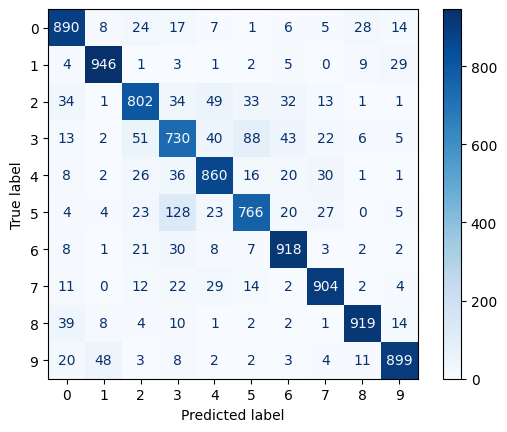

In [ ]:
ConfusionMatrixDisplay.from_predictions(y_true=y_true,y_pred=y_preds,cmap='Blues')

Accuracy in test data in with no validation set is 86.33%

## Testing with random Google image:

In [ ]:
from PIL import Image

In [ ]:
classes = ['airplane' ,'automobile', 'bird' , 'cat' , 'deer' ,'dog' ,'frog', 'horse' ,'ship' ,'truck']

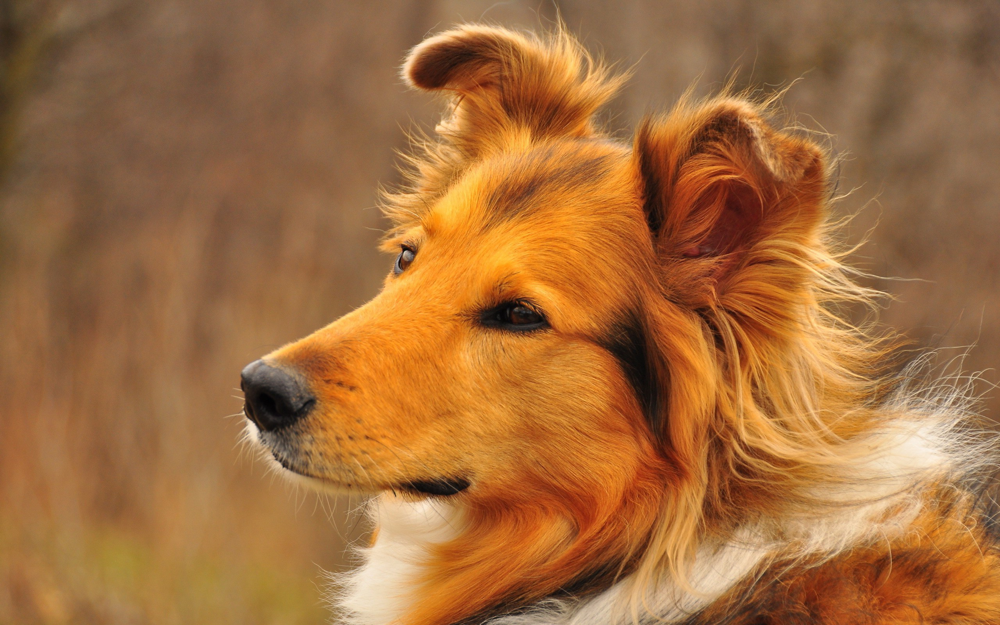

1/1 [==============================] - 0s 44ms/step


'dog'

In [ ]:
image=Image.open("drive/MyDrive/Colab Notebooks/Cifar10/1.jpg")
image.show()
image = image.resize((32,32), Image.ANTIALIAS)

a=tf.convert_to_tensor(image)
a=a/255
a=tf.expand_dims(a,axis=0)
prediction=model.predict(a)
classes[prediction.argmax()]

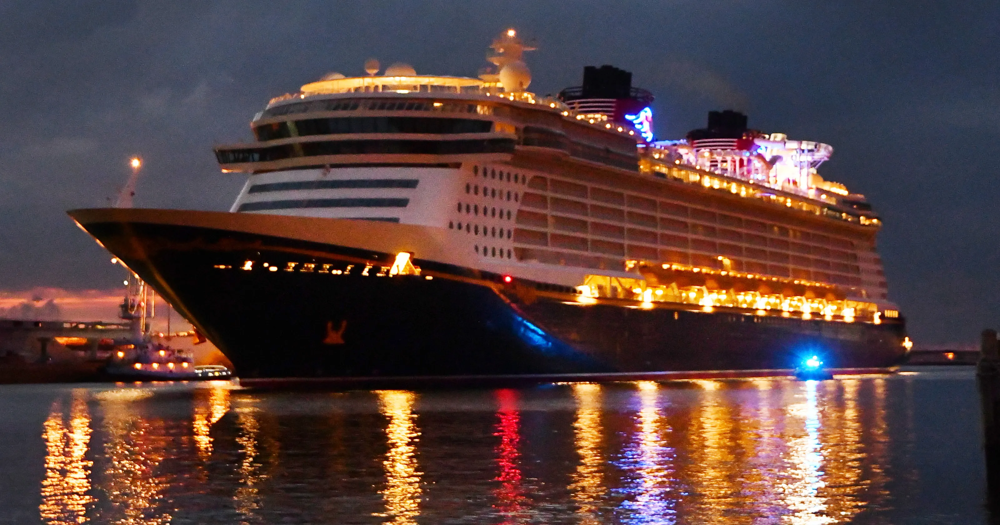

1/1 [==============================] - 0s 34ms/step


'ship'

In [ ]:
image=Image.open("drive/MyDrive/Colab Notebooks/Cifar10/2.webp")
image.show()
image = image.resize((32,32), Image.ANTIALIAS)

a=tf.convert_to_tensor(image)
a=a/255
a=tf.expand_dims(a,axis=0)
prediction=model.predict(a)
classes[prediction.argmax()]

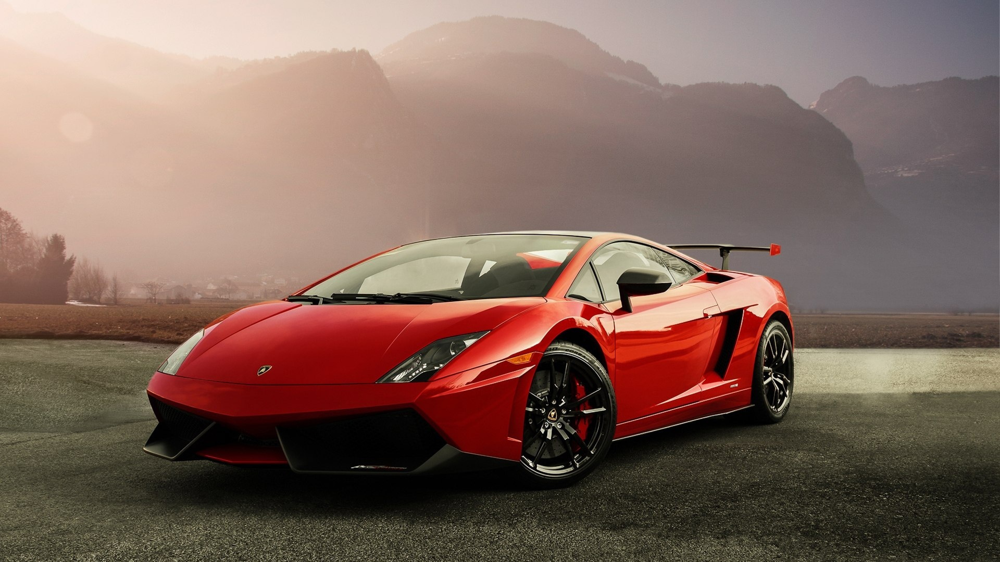

1/1 [==============================] - 0s 45ms/step
automobile


In [ ]:
image=Image.open("drive/MyDrive/Colab Notebooks/Cifar10/3.jpg")
image.show()
image = image.resize((32,32), Image.ANTIALIAS)

a=tf.convert_to_tensor(image)
a=a/255
a=tf.expand_dims(a,axis=0)
prediction=model.predict(a)
print(classes[prediction.argmax()])

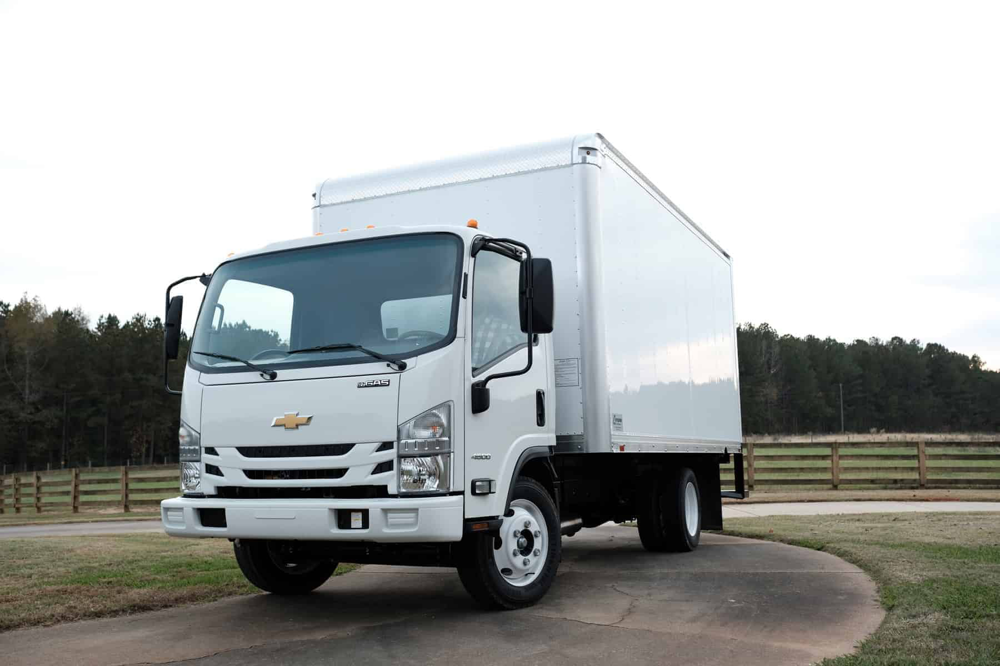

1/1 [==============================] - 0s 30ms/step


'truck'

In [ ]:
image=Image.open("drive/MyDrive/Colab Notebooks/Cifar10/4.jpg")
image.show()
image = image.resize((32,32), Image.ANTIALIAS)

a=tf.convert_to_tensor(image)
a=a/255
a=tf.expand_dims(a,axis=0)
prediction=model.predict(a)
classes[prediction.argmax()]

#4 **Tensorboard visualisation for training with validation set For CNN Model**

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir drive/MyDrive/Colab\ Notebooks/Cifar10/logtb

<IPython.core.display.Javascript object>

#5 **Custom Residual Model**

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, Add, GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Model

def residual_block(x, filters, downsample=False):
    # Shortcut branch
    shortcut = x

    # First conv layer
    strides = (2, 2) if downsample else (1, 1)
    x = Conv2D(filters, kernel_size=(3, 3), strides=strides, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # Second conv layer
    x = Conv2D(filters, kernel_size=(3, 3), padding='same')(x)
    x = BatchNormalization()(x)

    # Downsample the shortcut to match the shape of x
    if downsample:
        shortcut = Conv2D(filters, kernel_size=(1, 1), strides=(2, 2), padding='same')(shortcut)
        shortcut = BatchNormalization()(shortcut)

    # Add the shortcut to the main path
    x = Add()([x, shortcut])
    x = Activation('relu')(x)
    return x



def create_resnet_model(input_shape, num_classes):
    inputs = Input(shape=input_shape)

    # Initial conv layer
    x = Conv2D(64, kernel_size=(3, 3), strides=(1, 1), padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # Residual blocks
    x = residual_block(x, filters=64)
    x = residual_block(x, filters=64)
    x = residual_block(x, filters=128, downsample=True)
    x = residual_block(x, filters=128)
    x = residual_block(x, filters=256, downsample=True)
    x = residual_block(x, filters=256)

    # Global average pooling and final dense layer
    x = GlobalAveragePooling2D()(x)
    outputs = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# Create the ResNet model for CIFAR-10
input_shape = (32, 32, 3)
num_classes = 10
resnet_model = create_resnet_model(input_shape, num_classes)

# Compile the model
resnet_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
resnet_model.summary()


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 32, 32, 3)]  0           []                               
                                                                                                  
 conv2d (Conv2D)                (None, 32, 32, 64)   1792        ['input_2[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 32, 32, 64)  256         ['conv2d[0][0]']                 
 alization)                                                                                       
                                                                                                  
 activation (Activation)        (None, 32, 32, 64)   0           ['batch_normalization[0][0]']

In [ ]:
data=preprocessing(x_train,y_train)

In [ ]:
history=resnet_model.fit(data,epochs=30)

Epoch 1/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.8524 - accuracy: 0.7019
Epoch 2/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.6464 - accuracy: 0.7731
Epoch 3/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.5182 - accuracy: 0.8206
Epoch 4/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.4285 - accuracy: 0.8515
Epoch 5/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.3426 - accuracy: 0.8802
Epoch 6/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.2758 - accuracy: 0.9044
Epoch 7/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.2151 - accuracy: 0.9243
Epoch 8/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.1604 - accuracy: 0.9434
Epoch 9/30
1563/1563 [==============================] - 44s 28ms/step - loss: 0.1282 - accuracy: 0.9549
Epoch 10/30
1563/1563 [==============================] - 44s 28m

In [ ]:
a,b=to_tensors(x_test,y_test)
resnet_model.evaluate(a,b)

313/313 [==============================] - 4s 11ms/step - loss: 0.8147 - accuracy: 0.8408


[0.8146928548812866, 0.8407999873161316]

In [ ]:
print(classification_report(y_preds,y_true))

              precision    recall  f1-score   support

           0       0.96      0.66      0.78      1455
           1       0.94      0.93      0.93      1012
           2       0.78      0.78      0.78      1005
           3       0.68      0.73      0.70       922
           4       0.84      0.83      0.84      1009
           5       0.74      0.85      0.80       872
           6       0.84      0.93      0.88       899
           7       0.83      0.95      0.89       873
           8       0.88      0.93      0.90       943
           9       0.92      0.91      0.91      1010

    accuracy                           0.84     10000
   macro avg       0.84      0.85      0.84     10000
weighted avg       0.85      0.84      0.84     10000



In [ ]:
print(confusion_matrix(y_preds,y_true))

[[963  25 114  76  35  34  41  54  82  31]
 [  4 940   1   9   1   2   0   3  16  36]
 [  5   0 779  53  42  36  63  21   3   3]
 [  2   0  32 675  40 117  36  16   4   0]
 [  1   1  35  38 842  35  12  44   0   1]
 [  1   0  10  85  10 745   4  16   0   1]
 [  0   0  12  26  14   8 836   1   1   1]
 [  2   0   4   9   9  17   1 830   1   0]
 [ 15   3   9  14   5   4   4   2 879   8]
 [  7  31   4  15   2   2   3  13  14 919]]


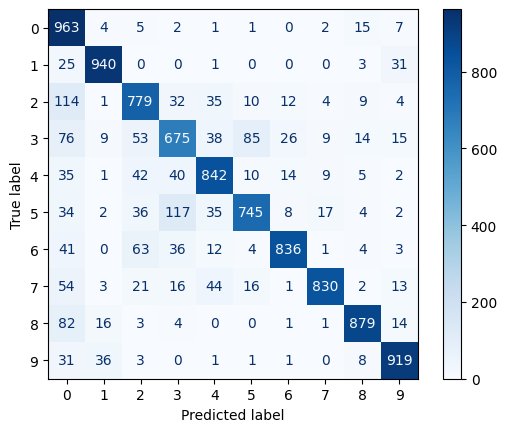

In [ ]:
ConfusionMatrixDisplay.from_predictions(y_true=y_true,y_pred=y_preds,cmap='Blues')

In [ ]:
resnet_model.save("drive/MyDrive/Colab Notebooks/Cifar10/saves/resnet_model",save_format='tf')

In [ ]:
a,b=to_tensors(x_test,y_test)
y_preds=resnet_model.predict(a)
y_preds=[np.argmax(x) for x in y_preds]
y_true=[np.argmax(x) for x in y_test]

313/313 [==============================] - 3s 8ms/step


In [ ]:
a,b=to_tensors(x_test,y_test)
resnet_model.evaluate(a,b)

313/313 [==============================] - 7s 17ms/step - loss: 0.3048 - accuracy: 0.9959


[0.30479639768600464, 0.9958999752998352]

In [ ]:
a,b=to_tensors(x_test,y_test)
y_preds=resnet_model.predict(a)
y_preds=[np.argmax(x) for x in y_preds]
y_true=[np.argmax(x) for x in y_test]

313/313 [==============================] - 8s 10ms/step


## Trials(not required):


*   Trying the model for first time with first few thousand datasets
*   Visualising augmented data



In [ ]:
train_x,train_y=to_tensors(x_train[:2000],y_train[:2000])


In [ ]:
model.fit(train_x,train_y,batch_size=32,epochs=15)

Epoch 1/15
63/63 [==============================] - 7s 84ms/step - loss: 2.1645 - accuracy: 0.1815
Epoch 2/15
63/63 [==============================] - 6s 89ms/step - loss: 1.8839 - accuracy: 0.3095
Epoch 3/15
63/63 [==============================] - 6s 96ms/step - loss: 1.6942 - accuracy: 0.3625
Epoch 4/15
63/63 [==============================] - 6s 97ms/step - loss: 1.5586 - accuracy: 0.4180
Epoch 5/15
63/63 [==============================] - 7s 106ms/step - loss: 1.3683 - accuracy: 0.4960
Epoch 6/15
63/63 [==============================] - 6s 86ms/step - loss: 1.1684 - accuracy: 0.5790
Epoch 7/15
63/63 [==============================] - 7s 107ms/step - loss: 1.0083 - accuracy: 0.6380
Epoch 8/15
63/63 [==============================] - 12s 188ms/step - loss: 0.8851 - accuracy: 0.6725
Epoch 9/15
63/63 [==============================] - 11s 171ms/step - loss: 0.6382 - accuracy: 0.7720
Epoch 10/15
63/63 [==============================] - 6s 94ms/step - loss: 0.4043 - accuracy: 0.8625
Epo

In [ ]:
a,b=to_tensors(x_train[4000],y_train[4000])

In [ ]:
a=tf.expand_dims(a,axis=0)
prediction=model.predict(a)

1/1 [==============================] - 0s 37ms/step


In [ ]:
np.argmax(prediction)

5

In [ ]:
y_train[4000]

array([0, 0, 0, 0, 0, 1, 0, 0, 0, 0])

In [ ]:
prediction

array([[5.1250374e-03, 1.0192441e-05, 9.8714547e-04, 3.9437050e-01,
        4.9983615e-01, 1.8351180e-04, 3.9085056e-04, 9.5515653e-02,
        8.7187509e-05, 3.4938122e-03]], dtype=float32)

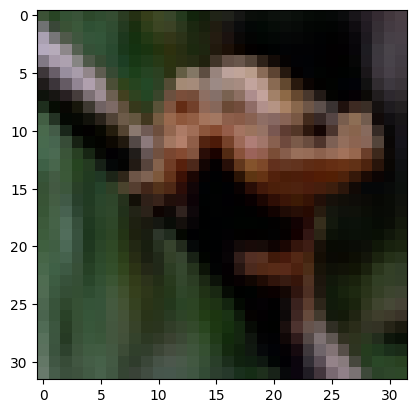

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(x_train[5000])

In [ ]:
train_x,train_y=to_tensors(x_train,y_train)

In [ ]:
a,b=to_tensors(x_test,y_test)

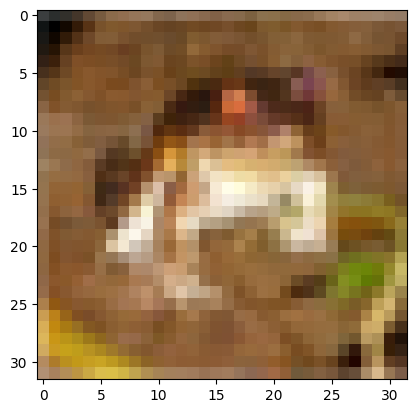

In [ ]:
plt.imshow(x_train[0])


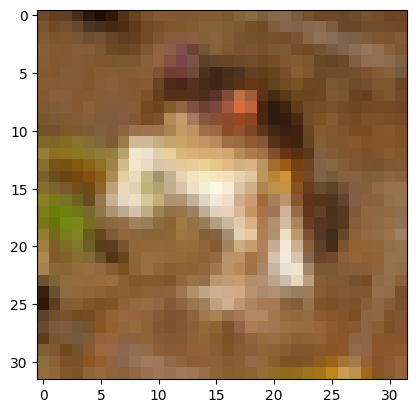

In [ ]:
image = tf.clip_by_value(k, 0, 255)
image = tf.cast(image, tf.uint8)
plt.imshow(image)

#6 **Error Correction and Algorithm**


*   **Error Correction Procedure :** Used Early Stopping and Data Augmentation
*   **Algorithm Used :**Dense Neural Network, Convolutional Neural Network, Custom made by referring,
VGG-16, LeNet-5 etc,ResNET.